In [1]:
import altair as alt
import cnvutils
import cptac
import IPython.display
import numpy as np
import os
import pandas as pd

from cnvutils.filenames import (
    get_has_event_path,
    get_ttest_results_path,
    get_protein_ttest_boxplot_path,
)

from cnvutils.constants import (
    CHART_FORMAT,
    CHART_RENDER_METHOD,
    CHART_SCALE,
    SIG_CUTOFF,
)

from cnvutils.load_data import (
    get_cnv_counts,
    get_tables,
    get_ensembl_gene_locations,
    get_ncbi_gene_locations,
)

from cnvutils.chromosome_funcs import (
    select_genes_for_event,
)

In [2]:
def make_protein_ttest_plots(
    chromosome,
    arm,
    event_start,
    event_end,
    gain_or_loss,
    cis_or_trans,
    proteomics_or_transcriptomics,
    cancer_types,
    source,
    level=None,
    data_dir=os.path.join(os.getcwd(), "..", "..", "data"),
):
    # Get ttest results to later pick which proteins to plot
    comparison_name = "tumor_vs_normal"
    has_ttest_results_path = get_ttest_results_path(
        data_dir=data_dir,
        source=source,
        level=level,
        chromosome=chromosome,
        arm=arm,
        gain_or_loss=gain_or_loss,
        cis_or_trans=cis_or_trans,
        proteomics_or_transcriptomics=proteomics_or_transcriptomics,
        group="has_event",
        comparison_name=comparison_name,
    )

    has_ttest_results = pd.read_csv(has_ttest_results_path, sep="\t")
        
    not_has_ttest_results_path = get_ttest_results_path(
        data_dir=data_dir,
        source=source,
        level=level,
        chromosome=chromosome,
        arm=arm,
        gain_or_loss=gain_or_loss,
        cis_or_trans=cis_or_trans,
        proteomics_or_transcriptomics=proteomics_or_transcriptomics,
        group="not_has_event",
        comparison_name=comparison_name,
    )

    not_has_ttest_results = pd.read_csv(not_has_ttest_results_path, sep="\t")
    
    # Get omics tables
    omics_dict = get_tables(
        data_dir=data_dir,
        source="cptac",
        data_types=[proteomics_or_transcriptomics],
        cancer_types=cancer_types,
    )
    omics_dict = omics_dict[proteomics_or_transcriptomics]

    # Get gene locations
    gene_locations = get_ensembl_gene_locations(data_dir=data_dir)

    # Select proteins
    # Note that the cnvutils.get_event_genes function uses Ensembl gene IDs for the 
    # Database_ID column, while the proteomics dataframes that have a Database_ID column
    # use RefSeq protein IDs. So, when we're selecting the genes we want, we ignore the 
    # Database_ID column if it is present, and just use gene names.
    selected_genes = select_genes_for_event(
        gene_locations=gene_locations,
        chromosome=chromosome,
        event_start=event_start,
        event_end=event_end,
        cis_or_trans=cis_or_trans,
    ).reset_index(drop=False)["Name"]

    to_drop = [] # For any empty dataframes
    for cancer_type in omics_dict.keys():
        
        df = omics_dict[cancer_type]

        df = df.transpose().\
        reset_index()

        df.columns.name = None

        # Get just the genes we want
        df = df[df["Name"].isin(selected_genes)]

        # Standardize index
        if "Database_ID" not in df.columns:
            df.insert(loc=1, column="Database_ID", value=np.nan)

        # Set the index again
        df = df.set_index(["Name", "Database_ID"])

        omics_dict[cancer_type] = df

    # Join in has_event data
    to_drop = [] # For any empty dataframes
    has_dict = {}
    not_has_dict = {}
    for cancer_type in omics_dict.keys():
        df = omics_dict[cancer_type]
        df = df.transpose()

        event_path = get_has_event_path(
            data_dir=data_dir,
            source=source,
            cancer_type=cancer_type,
            level=level,
            chromosome=chromosome,
            arm=arm,
            gain_or_loss=gain_or_loss,
        )
        event = pd.read_csv(event_path, sep='\t', index_col=0)

        event.columns.name = "Name"
        event.columns = cptac.dataframe_tools.add_index_levels(
            to=event.columns,
            source=df.columns,
            fill="",
        )

        # Create tissue_type column
        df = df.assign(tumor=~df.index.str.endswith(".N"))

        # Remove normal sample patient ID suffixes
        df.index = np.where(
            df.index.str.endswith(".N"),
            df.index.str[:-2],
            df.index,
        )

        # Join to event table
        df = df.\
        join(event, how="inner").\
        drop(columns=("proportion", ""))

        # Split on event status

        has = df[df["event"]]
        not_has = df[~df["event"]]

        for df in [has, not_has]:
            
            # Drop has_event column
            df = df.drop(columns=("event", ""))

        has_dict[cancer_type] = has
        not_has_dict[cancer_type] = not_has

    # Make plots
    save_paths = []
    for cancer_type in cancer_types:
        
        # Select just the genes for our cancer type
        has_p = has_ttest_results[has_ttest_results["cancer_type"] == cancer_type]
        not_has_p = not_has_ttest_results[not_has_ttest_results["cancer_type"] == cancer_type]
        
        # Get the ones that change in normal but not tumor
        has_not_sig_prots = set(has_p[has_p["adj_p"] >= SIG_CUTOFF]["protein"])
        not_has_sig_prots = set(not_has_p[not_has_p["adj_p"] <= SIG_CUTOFF]["protein"])
        plot_prots = has_not_sig_prots.intersection(not_has_sig_prots)
        
        all_prots_has = has_dict[cancer_type]
        all_prots_not_has = not_has_dict[cancer_type]

        for prot in plot_prots:
            
            for i, prots in enumerate([all_prots_has, all_prots_not_has]):

                prot_df = prots[[prot, "tumor"]].\
                droplevel("Database_ID", axis="columns")
                
                if prot_df.shape[1] == 3:
                    continue # Don't want to deal with isoforms

                prot_df = prot_df.assign(
                    tumor=prot_df["tumor"].replace({
                        True: "Tumor",
                        False: "Normal",
                    })
                )

                chart = alt.Chart(prot_df).mark_boxplot(
                    size=100,
                    extent='min-max',
                ).encode(
                    x=alt.X(
                        "tumor",
                        title=None,
                        sort="descending",
                        axis=alt.Axis(
                            ticks=False,
                            labelAngle=0,
                        ),
                    ),
                    y=alt.Y(
                        prot,
                        title=None,
                        axis=alt.Axis(
                            labels=False,
                            ticks=False,
                        ),
                    ),
                    color=alt.Color(
                        "tumor",
                        legend=None,
                    ),
                ).properties(
                    width=500,
                    height=400,
                    title=prot,
                ).configure(
                    padding=40,
                ).configure_axis(
                    labelFontSize=25,
                    labelPadding=10,
                    grid=False,
                    domainWidth=2,
                    domainColor="black",
                ).configure_title(
                    fontSize=25,
                ).configure_view(
                    strokeOpacity=0,
                )

                save_path = get_protein_ttest_boxplot_path(
                    data_dir=data_dir,
                    source=source, 
                    level=level, 
                    chromosome=chromosome, 
                    arm=arm, 
                    gain_or_loss=gain_or_loss, 
                    cancer_type=cancer_type,
                    cis_or_trans=cis_or_trans,
                    proteomics_or_transcriptomics=proteomics_or_transcriptomics,
                    group="has_event" if i == 0 else "not_has_event",
                    comparison_name=comparison_name,
                    protein=prot,
                    chart_format=CHART_FORMAT,
                )
                
                chart.save(save_path, method=CHART_RENDER_METHOD, scale_factor=CHART_SCALE)
                save_paths.append(save_path)
    
    return save_paths

In [3]:
paths = make_protein_ttest_plots(
    chromosome=8,
    arm="p",
    event_start=166085,
    event_end=40153481,
    gain_or_loss="loss",
    cis_or_trans="cis",
    proteomics_or_transcriptomics="proteomics",
    cancer_types=["hnscc"],
    source="gistic",
    level="gene",
)

INFO:tornado.access:200 GET / (::1) 4.77ms
INFO:tornado.access:200 GET / (::1) 4.77ms
INFO:tornado.access:200 GET /vega.js (::1) 3.51ms
INFO:tornado.access:200 GET /vega.js (::1) 3.51ms
INFO:tornado.access:200 GET /vega-lite.js (::1) 6.72ms
INFO:tornado.access:200 GET /vega-lite.js (::1) 6.72ms
INFO:tornado.access:200 GET /vega-embed.js (::1) 9.42ms
INFO:tornado.access:200 GET /vega-embed.js (::1) 9.42ms
INFO:tornado.access:304 GET / (::1) 0.94ms
INFO:tornado.access:304 GET / (::1) 0.94ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 3.71ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 3.71ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 6.79ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 6.79ms
INFO:tornado.access:304 GET /vega.js (::1) 4.94ms
INFO:tornado.access:304 GET /vega.js (::1) 4.94ms
INFO:tornado.access:304 GET / (::1) 0.44ms
INFO:tornado.access:304 GET / (::1) 0.44ms
INFO:tornado.access:304 GET /vega.js (::1) 3.12ms
INFO:tornado.access:304 GET /vega.js (::1) 3.12m

INFO:tornado.access:304 GET /vega.js (::1) 3.11ms
INFO:tornado.access:304 GET /vega.js (::1) 3.11ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.78ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.78ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 3.53ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 3.53ms
INFO:tornado.access:304 GET / (::1) 0.69ms
INFO:tornado.access:304 GET / (::1) 0.69ms
INFO:tornado.access:304 GET /vega.js (::1) 3.22ms
INFO:tornado.access:304 GET /vega.js (::1) 3.22ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.92ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.92ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 6.03ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 6.03ms
INFO:tornado.access:304 GET / (::1) 0.70ms
INFO:tornado.access:304 GET / (::1) 0.70ms
INFO:tornado.access:304 GET /vega.js (::1) 3.02ms
INFO:tornado.access:304 GET /vega.js (::1) 3.02ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.22ms
INFO:tornado.access:304 GET /

INFO:tornado.access:304 GET /vega.js (::1) 3.17ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.39ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.39ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 2.01ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 2.01ms
INFO:tornado.access:304 GET / (::1) 0.59ms
INFO:tornado.access:304 GET / (::1) 0.59ms
INFO:tornado.access:304 GET /vega.js (::1) 3.99ms
INFO:tornado.access:304 GET /vega.js (::1) 3.99ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.81ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.81ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 5.03ms
INFO:tornado.access:304 GET /vega-embed.js (::1) 5.03ms
INFO:tornado.access:304 GET / (::1) 0.63ms
INFO:tornado.access:304 GET / (::1) 0.63ms
INFO:tornado.access:304 GET /vega.js (::1) 4.18ms
INFO:tornado.access:304 GET /vega.js (::1) 4.18ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.45ms
INFO:tornado.access:304 GET /vega-lite.js (::1) 2.45ms
INFO:tornado.access:304 

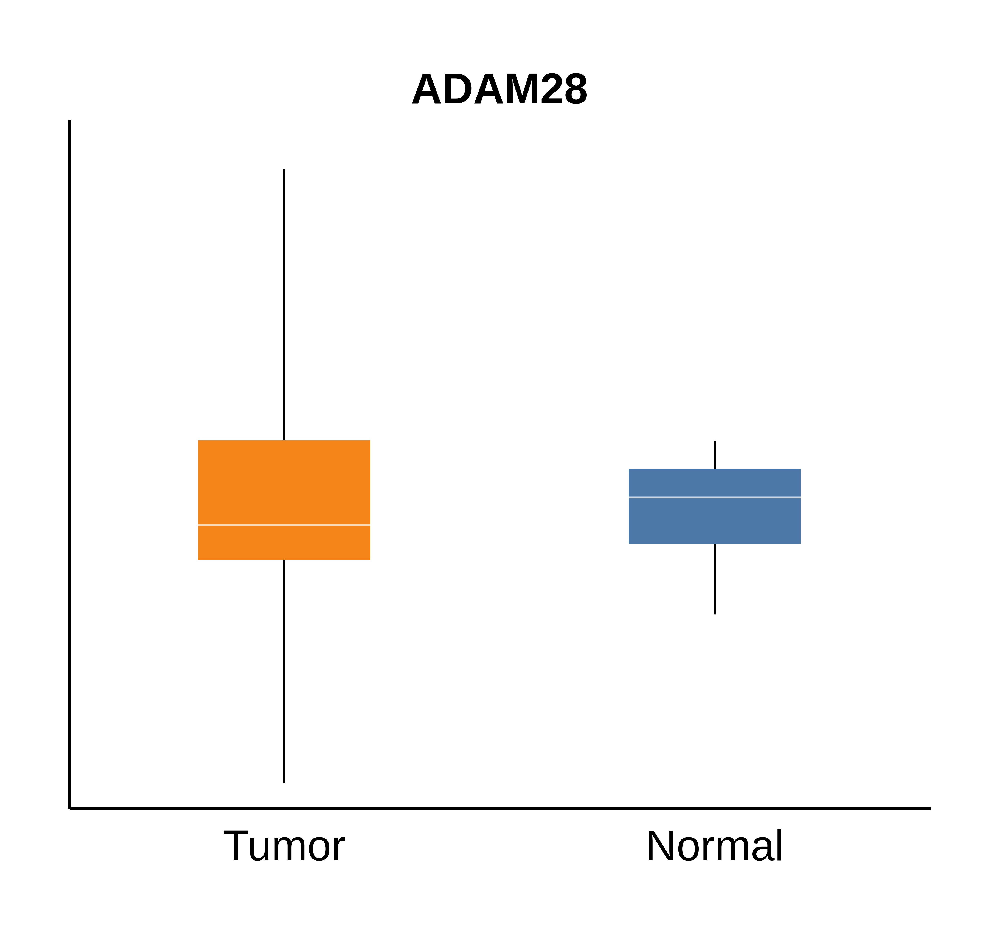

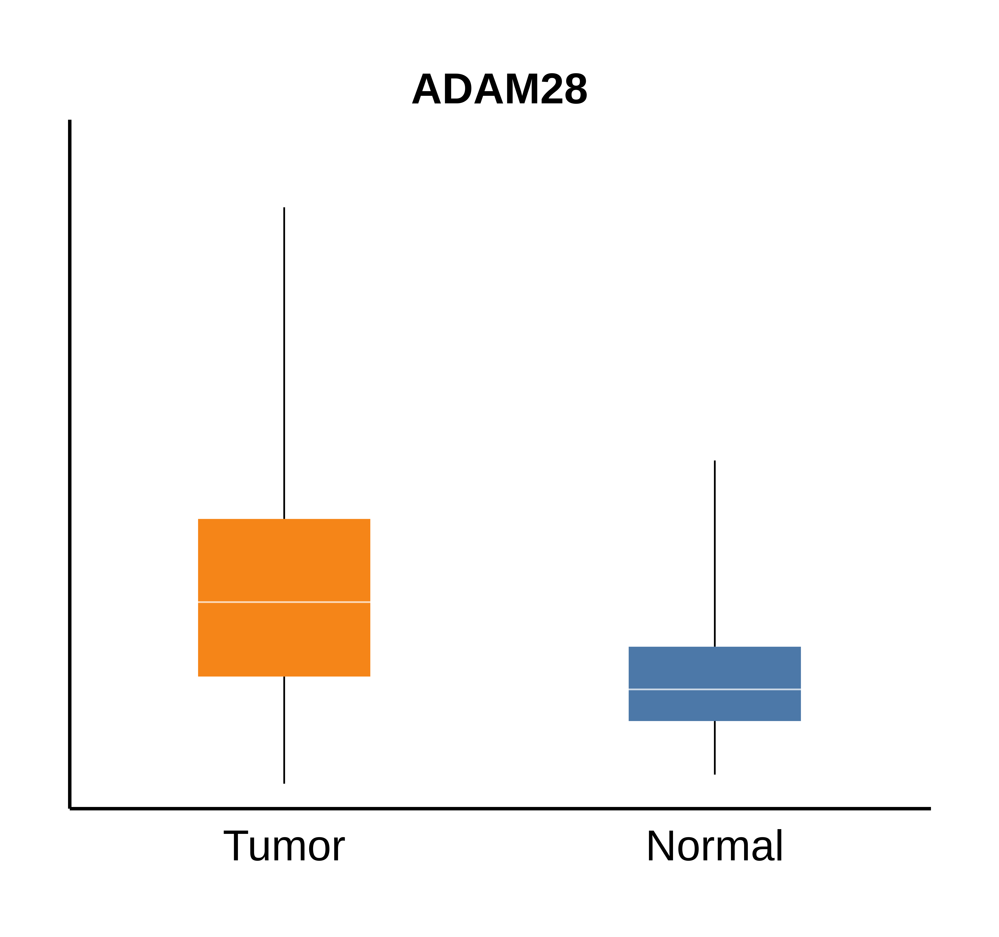

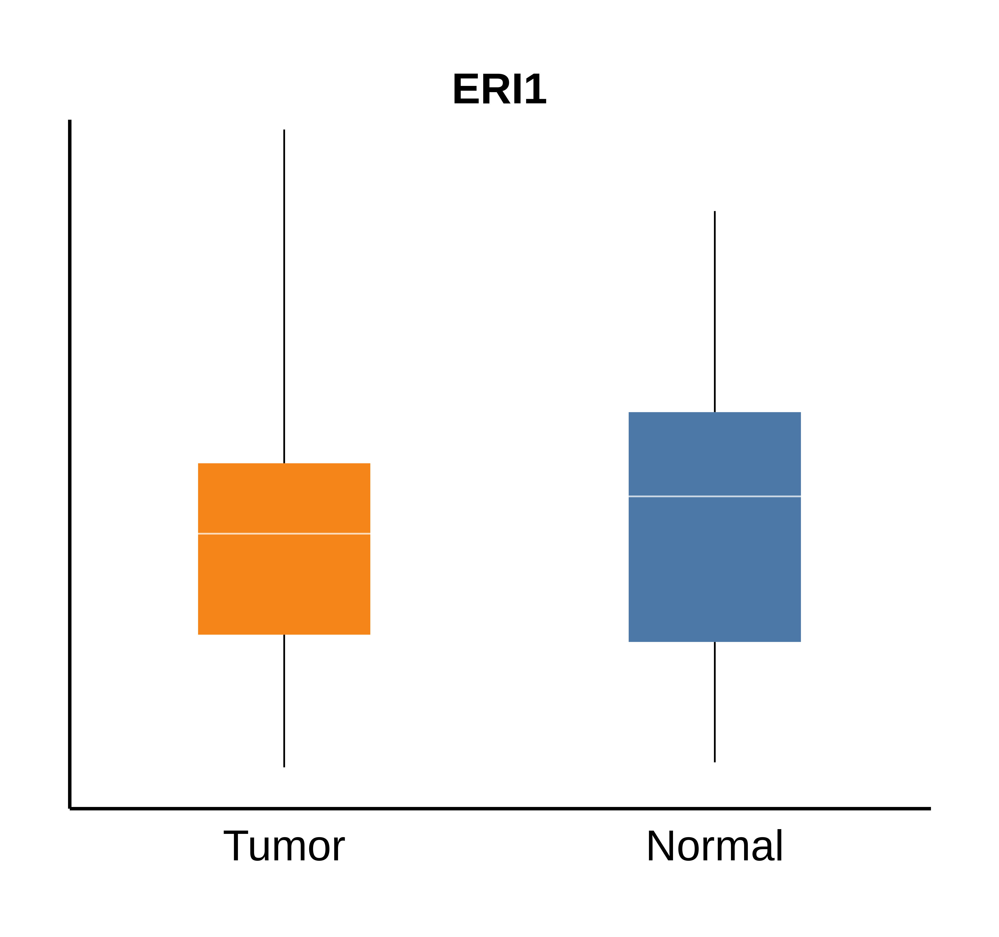

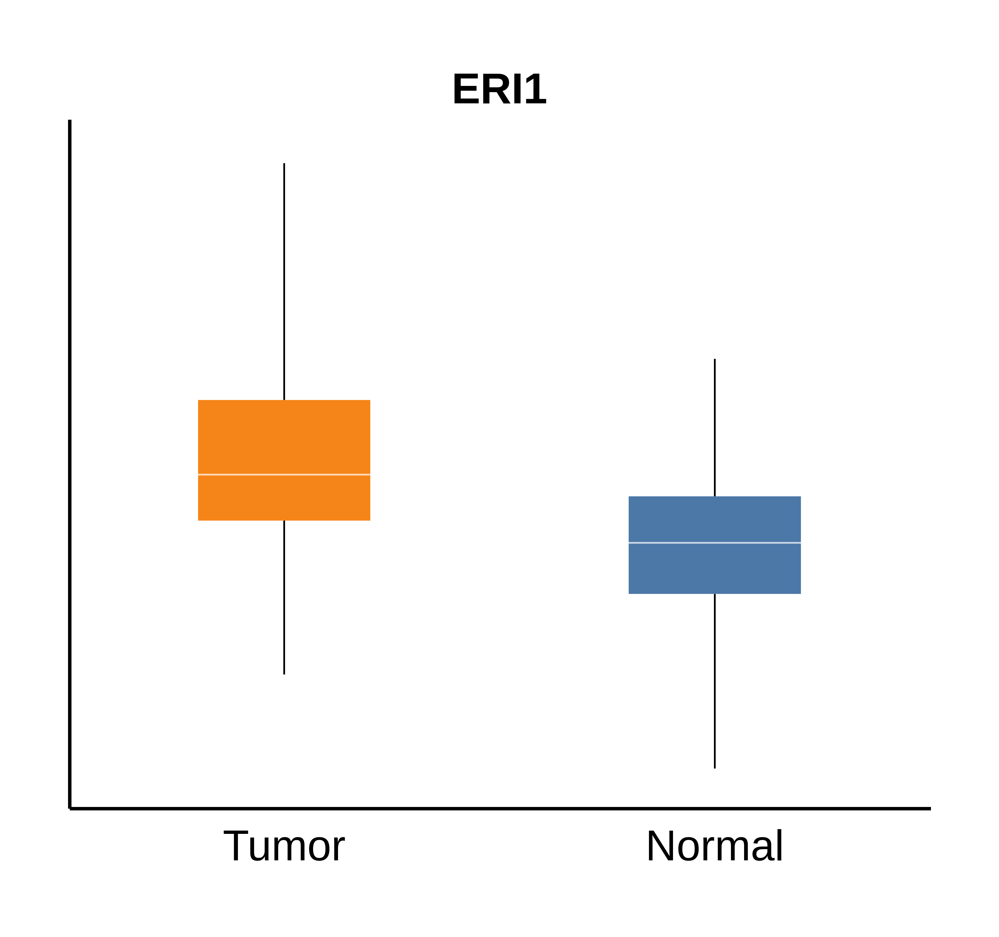

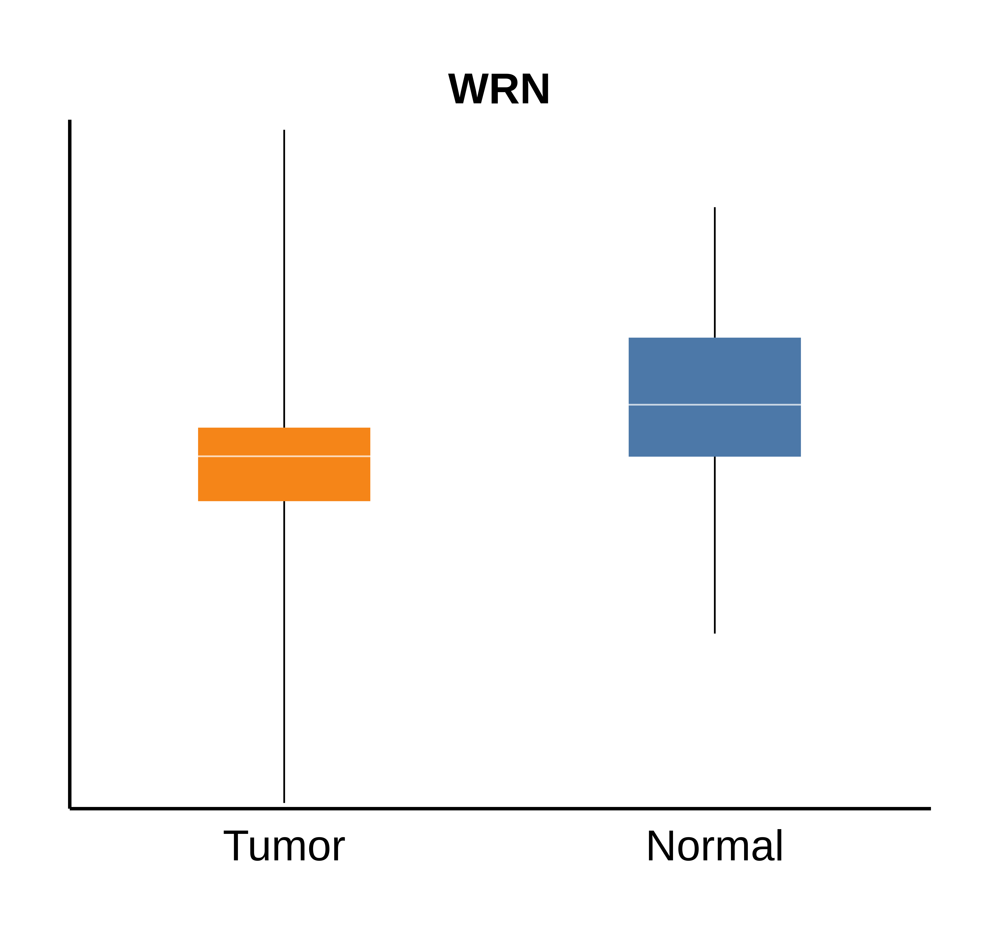

...

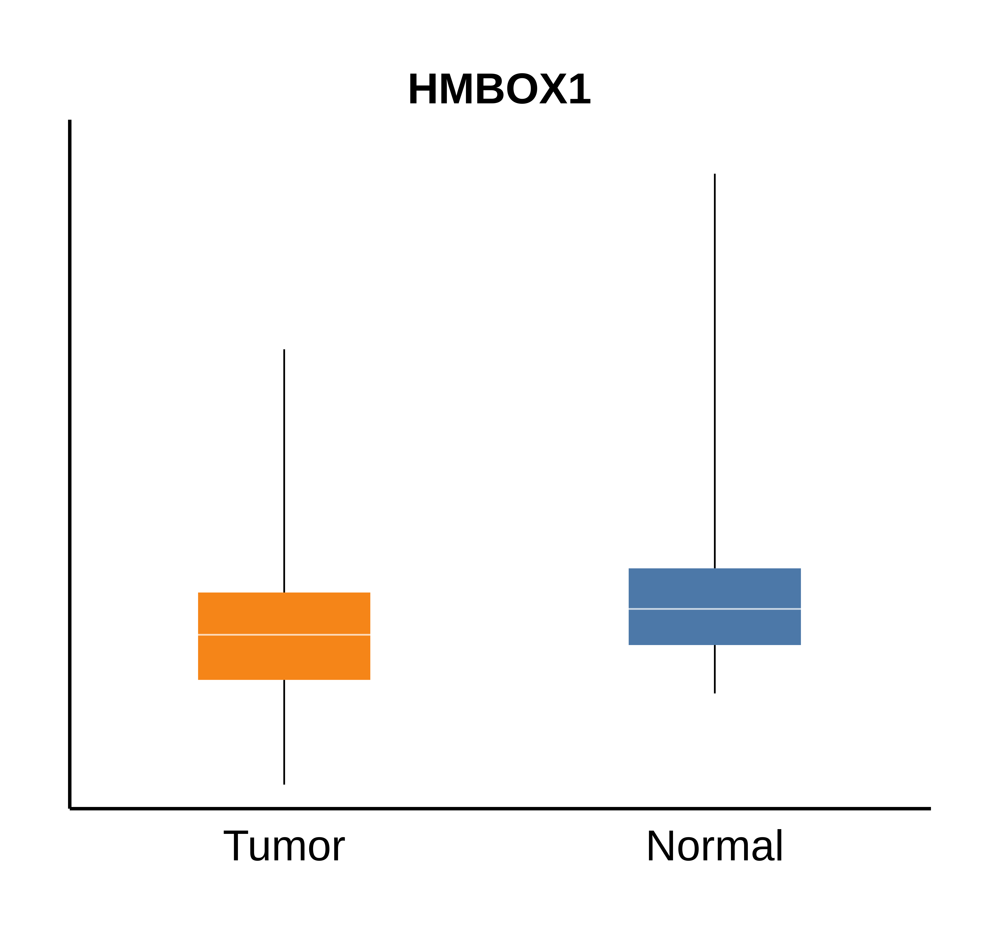

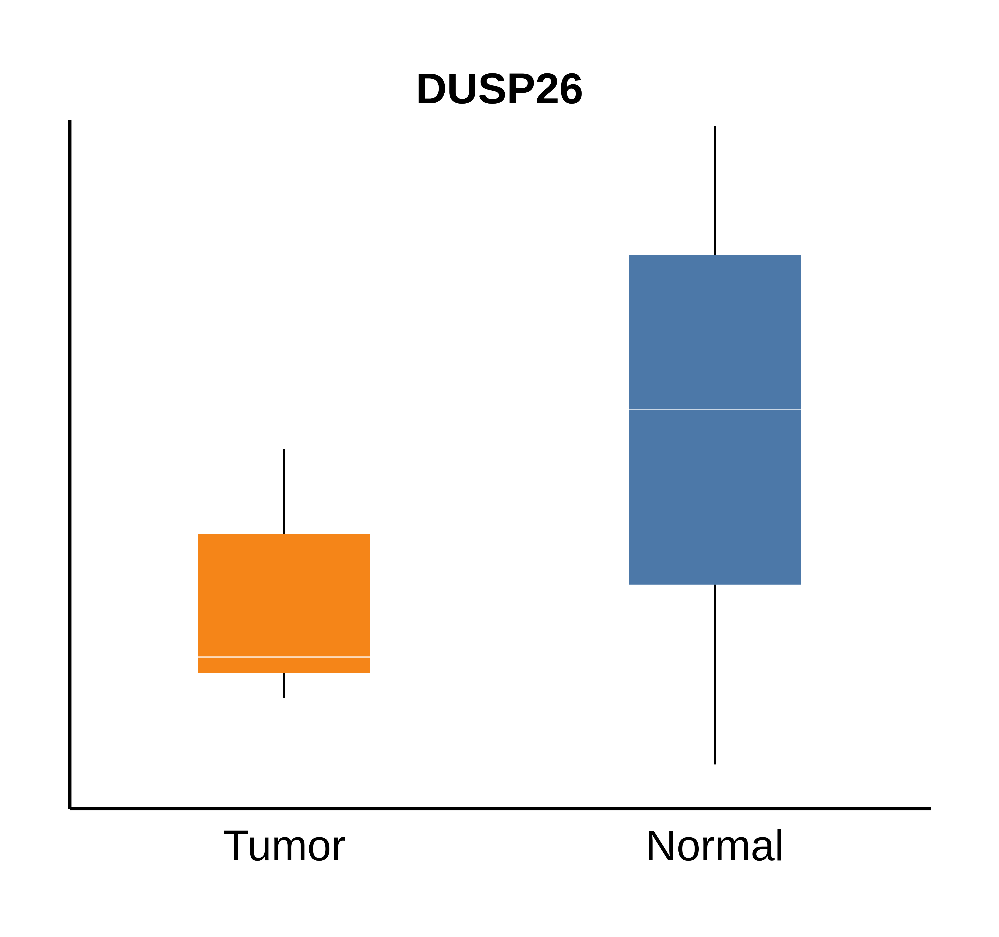

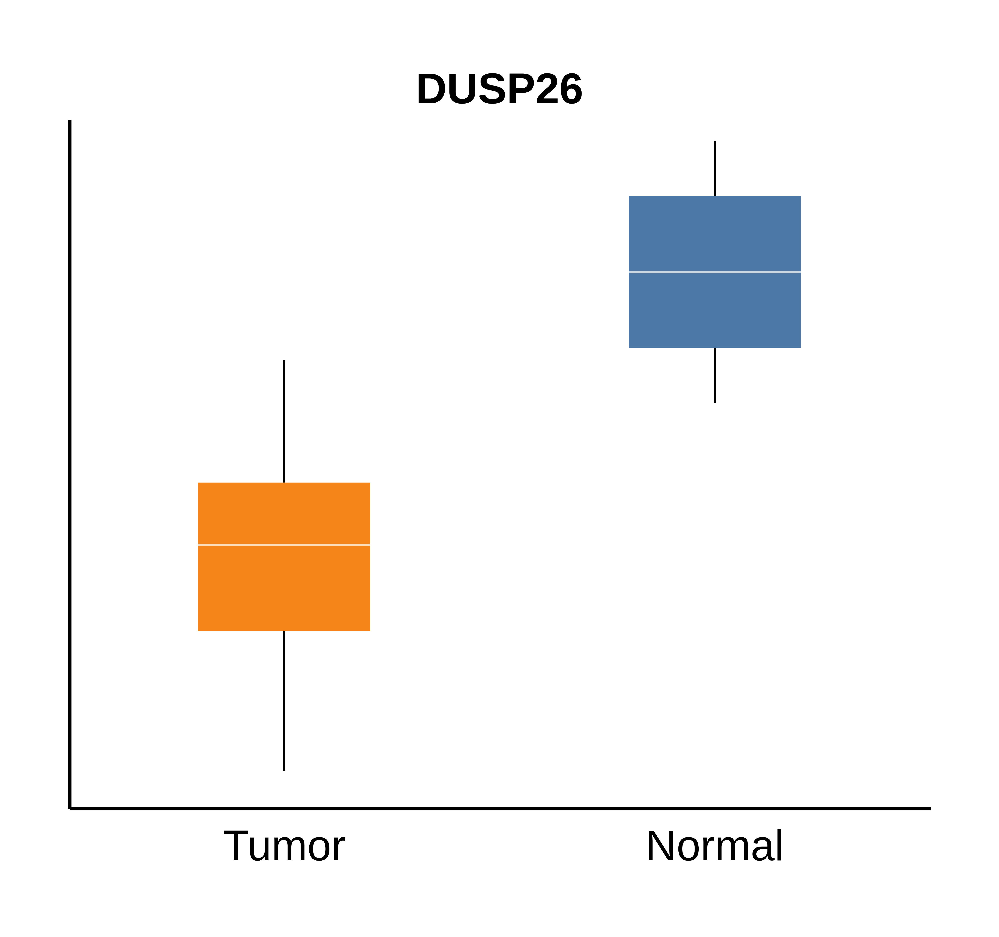

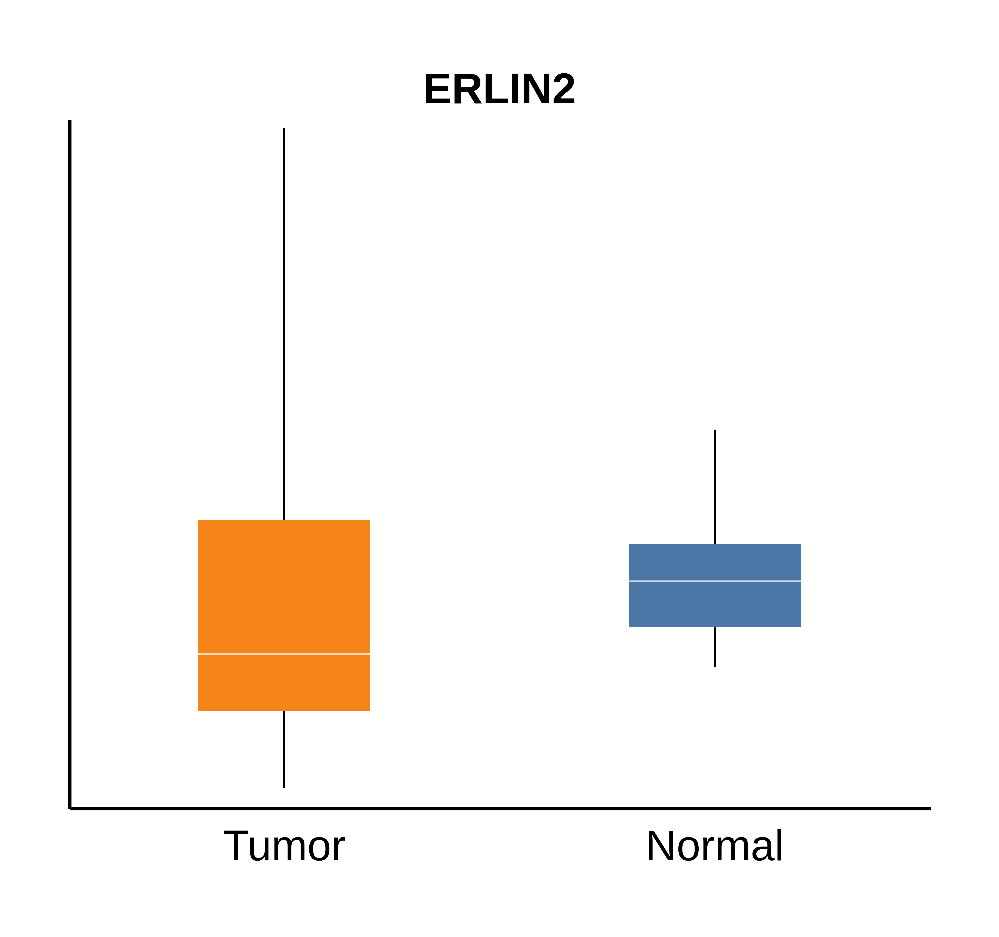

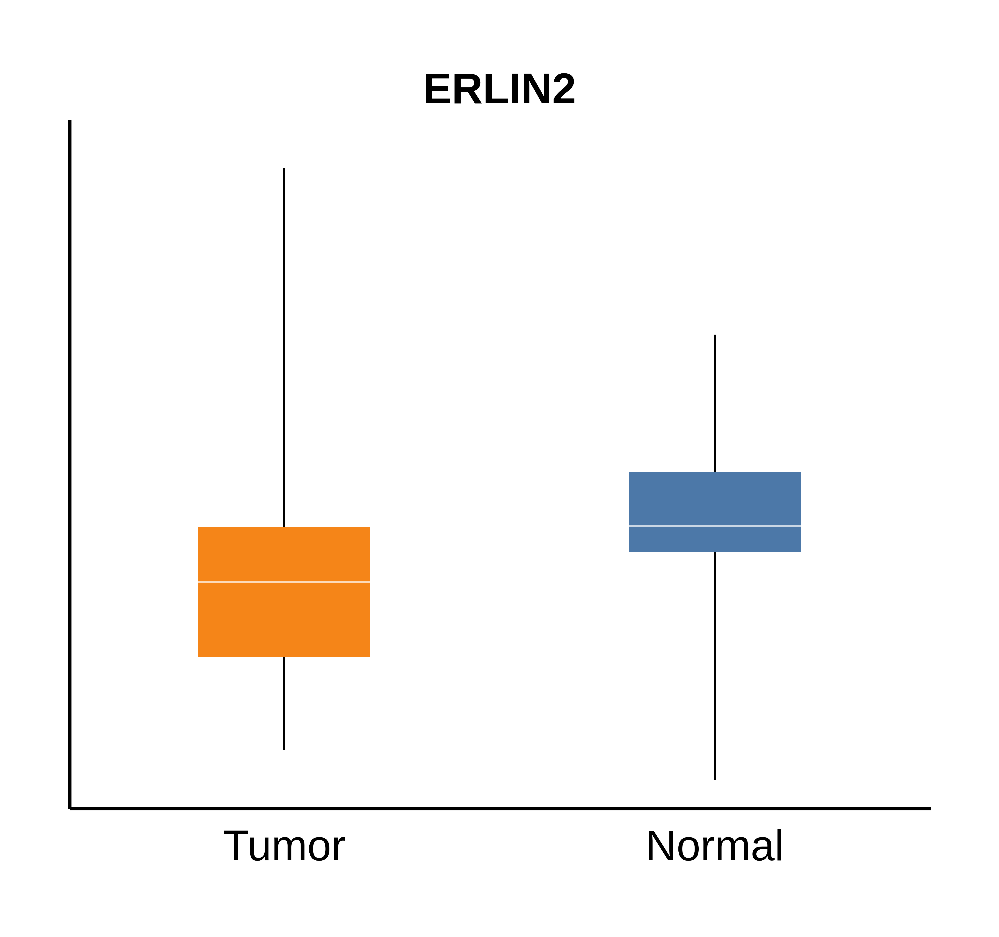

In [4]:
IPython.display.display(*[IPython.display.Image(path) for path in paths])